In [2]:
import os
import numpy as np
from os import listdir
from xml.etree import ElementTree
from numpy import zeros
from numpy import asarray
from numpy import expand_dims
from numpy import mean
import pydicom
import random
import matplotlib.pyplot as plt
import glob

In [3]:
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = '1'                        
import tensorflow as tf
import keras.backend as K
K.tensorflow_backend._get_available_gpus()

Using TensorFlow backend.


['/job:localhost/replica:0/task:0/device:GPU:0']

In [4]:
images = glob.glob('Z:/Lisa/PARISK/PARISK-MRI-CAROTID/*/MASSExport/T1W_*.dcm')
contours = glob.glob('Z:/Lisa/PARISK/PARISK-MRI-CAROTID/*/contours/*.dcm')

In [5]:
i = 707
print (images[i]) 
print (contours[i])

Z:/Lisa/PARISK/PARISK-MRI-CAROTID\MUMC091\MASSExport\T1W_0002.dcm
Z:/Lisa/PARISK/PARISK-MRI-CAROTID\MUMC091\contours\con_0002.dcm


In [6]:
img_dcm = pydicom.read_file(images[i], force = True)
img_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
img = img_dcm.pixel_array

con_dcm = pydicom.read_file(contours[i], force = True)
con_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
con = con_dcm.pixel_array

In [7]:
import os
import numpy as np

from skimage.io import imread, imshow, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

import tensorflow as tf

from keras.models import Model, load_model
from keras.layers import Input, BatchNormalization, Activation, Dense, Dropout
from keras.layers.core import Lambda, RepeatVector, Reshape
from keras.layers.convolutional import Conv2D, Conv2DTranspose
from keras.layers.pooling import MaxPooling2D, GlobalMaxPool2D
from keras.layers.merge import concatenate, add
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.optimizers import Adam
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
import os
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use("ggplot")



from tqdm import tqdm_notebook, tnrange
from itertools import chain
from sklearn.model_selection import train_test_split

In [8]:
from skimage.transform import resize

In [9]:
im_width = 128
im_height = 128
border = 5

In [10]:
X = np.zeros((len(images), 128, 128, 1))
y = np.zeros((len(images), 128, 128, 1))

In [11]:
for i in range (0, len(images)):
    
    img_dcm = pydicom.read_file(images[i], force = True)
    img_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
    img = img_dcm.pixel_array

    con_dcm = pydicom.read_file(contours[i], force = True)
    con_dcm.file_meta.TransferSyntaxUID = pydicom.uid.ImplicitVRLittleEndian
    con_array = con_dcm.pixel_array
    con = np.copy(con_array)
    #con = (con_array>0).astype(int) + (con_array>1).astype(int)
    #con = (con_array>0).astype(int)
    
    img_min = np.min(img) #!!!
    img_max = np.max(img) #!!!
    img_norm = np.copy((img - img_min)/(img_max - img_min)*255).astype(np.uint8)
    
    con_xmin = np.min(np.where(con > 0)[0])
    con_xmax = np.max(np.where(con > 0)[0])
    con_ymin = np.min(np.where(con > 0)[1])
    con_ymax = np.max(np.where(con > 0)[1])
    
    crop_xmin = con_xmin-random.randint(2,5)
    crop_ymin = con_ymin-random.randint(2,5)
    side = max(con_xmax-crop_xmin, con_ymax-crop_ymin)+random.randint(2,5)
    crop_xmax = crop_xmin + side
    crop_ymax = crop_ymin + side
    
    
    crop = [crop_xmin, crop_xmax, 
            crop_ymin, crop_ymax]
    
    img_norm_crop = np.copy(img_norm[crop[0]:crop[1], crop[2]:crop[3]])
    con_crop = np.copy(con[crop[0]:crop[1], crop[2]:crop[3]])
    
    x_img = resize(img_norm_crop, (128, 128, 1), preserve_range = True, anti_aliasing=False)
    mask = resize(con_crop, (128, 128, 1), preserve_range = True, anti_aliasing=False)
    
    X[i] = x_img
    y[i] = (mask>0).astype(int)
    
    #print (i, np.min(y[i]), np.max(y[i]))

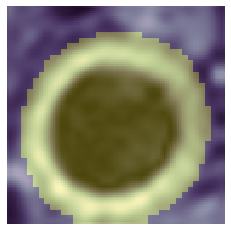

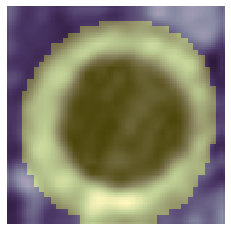

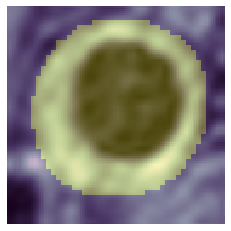

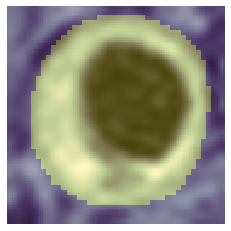

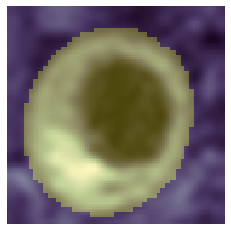

...

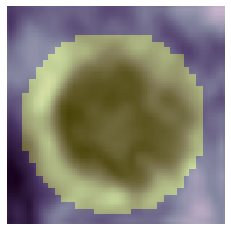

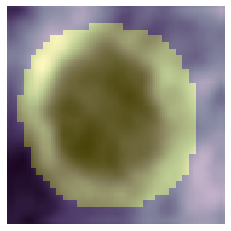

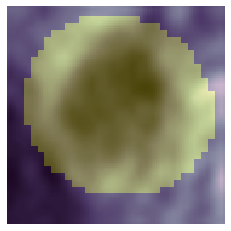

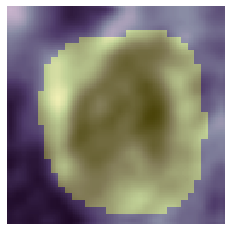

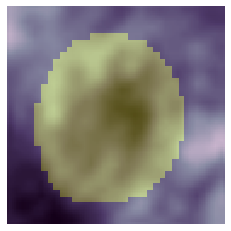

In [12]:
for i in range (0, len(images)):
    plt.imshow(X[i, ..., 0], cmap = 'bone')
    plt.imshow(y[i, ..., 0], alpha = 0.3)
    plt.axis('Off')
    plt.show()

In [13]:
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.1, random_state=42)
#Calculate test size ratio
test_size = (X_valid.shape[0]/X_train.shape[0])
# Split train and test
X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=test_size, random_state=42)

In [14]:
def conv2d_block(input_tensor, n_filters, kernel_size = 3, batchnorm = True):
    """Function to add 2 convolutional layers with the parameters passed to it"""
    # first layer
    x = Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # second layer
    x = Conv2D(filters = n_filters, kernel_size = (kernel_size, kernel_size),\
              kernel_initializer = 'he_normal', padding = 'same')(input_tensor)
    if batchnorm:
        x = BatchNormalization()(x)
    x = Activation('relu')(x)

    return x

def get_unet(input_img, n_filters = 8, dropout = 0.2, batchnorm = True):
    """Function to define the UNET Model"""
    # Contracting Path
    c1 = conv2d_block(input_img, n_filters * 1, kernel_size = 3, batchnorm = batchnorm)
    p1 = MaxPooling2D((2, 2))(c1)
    p1 = Dropout(dropout)(p1)

    c2 = conv2d_block(p1, n_filters * 2, kernel_size = 3, batchnorm = batchnorm)
    p2 = MaxPooling2D((2, 2))(c2)
    p2 = Dropout(dropout)(p2)

    c3 = conv2d_block(p2, n_filters * 4, kernel_size = 3, batchnorm = batchnorm)
    p3 = MaxPooling2D((2, 2))(c3)
    p3 = Dropout(dropout)(p3)

    c4 = conv2d_block(p3, n_filters * 8, kernel_size = 3, batchnorm = batchnorm)
    p4 = MaxPooling2D((2, 2))(c4)
    p4 = Dropout(dropout)(p4)

    c5 = conv2d_block(p4, n_filters = n_filters * 16, kernel_size = 3, batchnorm = batchnorm)

    # Expansive Path
    u6 = Conv2DTranspose(n_filters * 8, (3, 3), strides = (2, 2), padding = 'same')(c5)
    u6 = concatenate([u6, c4])
    u6 = Dropout(dropout)(u6)
    c6 = conv2d_block(u6, n_filters * 8, kernel_size = 3, batchnorm = batchnorm)

    u7 = Conv2DTranspose(n_filters * 4, (3, 3), strides = (2, 2), padding = 'same')(c6)
    u7 = concatenate([u7, c3])
    u7 = Dropout(dropout)(u7)
    c7 = conv2d_block(u7, n_filters * 4, kernel_size = 3, batchnorm = batchnorm)

    u8 = Conv2DTranspose(n_filters * 2, (3, 3), strides = (2, 2), padding = 'same')(c7)
    u8 = concatenate([u8, c2])
    u8 = Dropout(dropout)(u8)
    c8 = conv2d_block(u8, n_filters * 2, kernel_size = 3, batchnorm = batchnorm)

    u9 = Conv2DTranspose(n_filters * 1, (3, 3), strides = (2, 2), padding = 'same')(c8)
    u9 = concatenate([u9, c1])
    u9 = Dropout(dropout)(u9)
    c9 = conv2d_block(u9, n_filters * 1, kernel_size = 3, batchnorm = batchnorm)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)
    model = Model(inputs=[input_img], outputs=[outputs])
    return model

In [15]:
def dice_coef(y_true, y_pred):
    from keras import backend as K
    smooth=1
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

In [16]:
def dice_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

def custom_loss(y_true, y_pred):
    from keras.losses import binary_crossentropy
    return 0.5*keras.losses.binary_crossentropy(y_true,y_pred)+0.5*dice_loss(y_true,y_pred)

In [17]:
input_img = Input((im_height, im_width, 1), name='img')
model = get_unet(input_img, n_filters=16, dropout=0.05, batchnorm=True)

model.compile(optimizer=Adam(), loss=dice_loss, metrics=['accuracy', dice_coef])
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
img (InputLayer)                (None, 128, 128, 1)  0                                            
__________________________________________________________________________________________________
conv2d_2 (Conv2D)               (None, 128, 128, 16) 160         img[0][0]                        
__________________________________________________________________________________________________
batch_normalization_2 (BatchNor (None, 128, 128, 16) 64          conv2d_2[0][0]                   
__________________________________________________________________________________________________
activation_2 (Activat

activation_14 (Activation)      (None, 32, 32, 64)   0           batch_normalization_14[0][0]     
__________________________________________________________________________________________________
conv2d_transpose_3 (Conv2DTrans (None, 64, 64, 32)   18464       activation_14[0][0]              
__________________________________________________________________________________________________
concatenate_3 (Concatenate)     (None, 64, 64, 64)   0           conv2d_transpose_3[0][0]         
                                                                 activation_4[0][0]               
__________________________________________________________________________________________________
dropout_7 (Dropout)             (None, 64, 64, 64)   0           concatenate_3[0][0]              
__________________________________________________________________________________________________
conv2d_16 (Conv2D)              (None, 64, 64, 32)   18464       dropout_7[0][0]                  
__________

In [18]:
callbacks = [
    EarlyStopping(patience=10, verbose=1),
    ReduceLROnPlateau(factor=0.1, patience=3, min_lr=0.00001, verbose=1),
    ModelCheckpoint('model_vessel-outer-segmentation.h5', verbose=1, save_best_only=True, save_weights_only=True)
]

In [19]:
results = model.fit(X_train, y_train, batch_size=32, epochs=100, callbacks=callbacks, validation_data=(X_valid, y_valid))

Train on 878 samples, validate on 110 samples
Epoch 1/100
878/878 [==============================] - ETA: 3:06 - loss: 0.4121 - acc: 0.5694 - dice_coef: 0.587 - ETA: 1:30 - loss: 0.3979 - acc: 0.5864 - dice_coef: 0.602 - ETA: 58s - loss: 0.3873 - acc: 0.6017 - dice_coef: 0.612 - ETA: 42s - loss: 0.3793 - acc: 0.6141 - dice_coef: 0.62 - ETA: 32s - loss: 0.3703 - acc: 0.6296 - dice_coef: 0.62 - ETA: 26s - loss: 0.3614 - acc: 0.6444 - dice_coef: 0.63 - ETA: 21s - loss: 0.3523 - acc: 0.6596 - dice_coef: 0.64 - ETA: 18s - loss: 0.3413 - acc: 0.6758 - dice_coef: 0.65 - ETA: 15s - loss: 0.3303 - acc: 0.6919 - dice_coef: 0.66 - ETA: 13s - loss: 0.3195 - acc: 0.7075 - dice_coef: 0.68 - ETA: 11s - loss: 0.3091 - acc: 0.7221 - dice_coef: 0.69 - ETA: 10s - loss: 0.2987 - acc: 0.7356 - dice_coef: 0.70 - ETA: 8s - loss: 0.2902 - acc: 0.7468 - dice_coef: 0.7098 - ETA: 7s - loss: 0.2813 - acc: 0.7580 - dice_coef: 0.718 - ETA: 6s - loss: 0.2732 - acc: 0.7678 - dice_coef: 0.726 - ETA: 5s - loss: 0.2666 

878/878 [==============================] - ETA: 1s - loss: 0.0852 - acc: 0.9257 - dice_coef: 0.914 - ETA: 1s - loss: 0.0850 - acc: 0.9243 - dice_coef: 0.915 - ETA: 1s - loss: 0.0835 - acc: 0.9266 - dice_coef: 0.916 - ETA: 1s - loss: 0.0853 - acc: 0.9246 - dice_coef: 0.914 - ETA: 1s - loss: 0.0850 - acc: 0.9251 - dice_coef: 0.915 - ETA: 1s - loss: 0.0855 - acc: 0.9242 - dice_coef: 0.914 - ETA: 1s - loss: 0.0845 - acc: 0.9249 - dice_coef: 0.915 - ETA: 1s - loss: 0.0848 - acc: 0.9248 - dice_coef: 0.915 - ETA: 1s - loss: 0.0863 - acc: 0.9233 - dice_coef: 0.913 - ETA: 1s - loss: 0.0862 - acc: 0.9234 - dice_coef: 0.913 - ETA: 1s - loss: 0.0854 - acc: 0.9244 - dice_coef: 0.914 - ETA: 1s - loss: 0.0858 - acc: 0.9240 - dice_coef: 0.914 - ETA: 0s - loss: 0.0857 - acc: 0.9240 - dice_coef: 0.914 - ETA: 0s - loss: 0.0852 - acc: 0.9246 - dice_coef: 0.914 - ETA: 0s - loss: 0.0850 - acc: 0.9248 - dice_coef: 0.915 - ETA: 0s - loss: 0.0848 - acc: 0.9251 - dice_coef: 0.915 - ETA: 0s - loss: 0.0850 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0816 - acc: 0.9276 - dice_coef: 0.918 - ETA: 1s - loss: 0.0794 - acc: 0.9302 - dice_coef: 0.920 - ETA: 1s - loss: 0.0788 - acc: 0.9302 - dice_coef: 0.921 - ETA: 1s - loss: 0.0771 - acc: 0.9319 - dice_coef: 0.922 - ETA: 1s - loss: 0.0747 - acc: 0.9348 - dice_coef: 0.925 - ETA: 1s - loss: 0.0752 - acc: 0.9343 - dice_coef: 0.924 - ETA: 1s - loss: 0.0754 - acc: 0.9338 - dice_coef: 0.924 - ETA: 1s - loss: 0.0759 - acc: 0.9333 - dice_coef: 0.924 - ETA: 1s - loss: 0.0766 - acc: 0.9328 - dice_coef: 0.923 - ETA: 1s - loss: 0.0762 - acc: 0.9333 - dice_coef: 0.923 - ETA: 1s - loss: 0.0760 - acc: 0.9334 - dice_coef: 0.924 - ETA: 1s - loss: 0.0762 - acc: 0.9334 - dice_coef: 0.923 - ETA: 0s - loss: 0.0763 - acc: 0.9331 - dice_coef: 0.923 - ETA: 0s - loss: 0.0761 - acc: 0.9330 - dice_coef: 0.923 - ETA: 0s - loss: 0.0761 - acc: 0.9329 - dice_coef: 0.923 - ETA: 0s - loss: 0.0765 - acc: 0.9325 - dice_coef: 0.923 - ETA: 0s - loss: 0.0764 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0722 - acc: 0.9366 - dice_coef: 0.927 - ETA: 1s - loss: 0.0745 - acc: 0.9337 - dice_coef: 0.925 - ETA: 1s - loss: 0.0751 - acc: 0.9326 - dice_coef: 0.924 - ETA: 1s - loss: 0.0735 - acc: 0.9345 - dice_coef: 0.926 - ETA: 1s - loss: 0.0755 - acc: 0.9327 - dice_coef: 0.924 - ETA: 1s - loss: 0.0752 - acc: 0.9330 - dice_coef: 0.924 - ETA: 1s - loss: 0.0752 - acc: 0.9330 - dice_coef: 0.924 - ETA: 1s - loss: 0.0755 - acc: 0.9326 - dice_coef: 0.924 - ETA: 1s - loss: 0.0749 - acc: 0.9333 - dice_coef: 0.925 - ETA: 1s - loss: 0.0748 - acc: 0.9334 - dice_coef: 0.925 - ETA: 1s - loss: 0.0747 - acc: 0.9335 - dice_coef: 0.925 - ETA: 1s - loss: 0.0747 - acc: 0.9334 - dice_coef: 0.925 - ETA: 0s - loss: 0.0749 - acc: 0.9332 - dice_coef: 0.925 - ETA: 0s - loss: 0.0746 - acc: 0.9335 - dice_coef: 0.925 - ETA: 0s - loss: 0.0743 - acc: 0.9338 - dice_coef: 0.925 - ETA: 0s - loss: 0.0744 - acc: 0.9337 - dice_coef: 0.925 - ETA: 0s - loss: 0.0744 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0753 - acc: 0.9272 - dice_coef: 0.924 - ETA: 1s - loss: 0.0754 - acc: 0.9293 - dice_coef: 0.924 - ETA: 1s - loss: 0.0725 - acc: 0.9317 - dice_coef: 0.927 - ETA: 1s - loss: 0.0704 - acc: 0.9343 - dice_coef: 0.929 - ETA: 1s - loss: 0.0709 - acc: 0.9340 - dice_coef: 0.929 - ETA: 1s - loss: 0.0713 - acc: 0.9338 - dice_coef: 0.928 - ETA: 1s - loss: 0.0714 - acc: 0.9339 - dice_coef: 0.928 - ETA: 1s - loss: 0.0706 - acc: 0.9349 - dice_coef: 0.929 - ETA: 1s - loss: 0.0704 - acc: 0.9354 - dice_coef: 0.929 - ETA: 1s - loss: 0.0708 - acc: 0.9349 - dice_coef: 0.929 - ETA: 1s - loss: 0.0704 - acc: 0.9353 - dice_coef: 0.929 - ETA: 1s - loss: 0.0701 - acc: 0.9357 - dice_coef: 0.929 - ETA: 0s - loss: 0.0699 - acc: 0.9362 - dice_coef: 0.930 - ETA: 0s - loss: 0.0699 - acc: 0.9363 - dice_coef: 0.930 - ETA: 0s - loss: 0.0699 - acc: 0.9363 - dice_coef: 0.930 - ETA: 0s - loss: 0.0704 - acc: 0.9359 - dice_coef: 0.929 - ETA: 0s - loss: 0.0703 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0649 - acc: 0.9425 - dice_coef: 0.935 - ETA: 1s - loss: 0.0668 - acc: 0.9388 - dice_coef: 0.933 - ETA: 1s - loss: 0.0697 - acc: 0.9364 - dice_coef: 0.930 - ETA: 1s - loss: 0.0682 - acc: 0.9379 - dice_coef: 0.931 - ETA: 1s - loss: 0.0675 - acc: 0.9382 - dice_coef: 0.932 - ETA: 1s - loss: 0.0675 - acc: 0.9379 - dice_coef: 0.932 - ETA: 1s - loss: 0.0671 - acc: 0.9383 - dice_coef: 0.932 - ETA: 1s - loss: 0.0673 - acc: 0.9380 - dice_coef: 0.932 - ETA: 1s - loss: 0.0673 - acc: 0.9379 - dice_coef: 0.932 - ETA: 1s - loss: 0.0675 - acc: 0.9375 - dice_coef: 0.932 - ETA: 1s - loss: 0.0676 - acc: 0.9374 - dice_coef: 0.932 - ETA: 1s - loss: 0.0676 - acc: 0.9372 - dice_coef: 0.932 - ETA: 1s - loss: 0.0672 - acc: 0.9377 - dice_coef: 0.932 - ETA: 0s - loss: 0.0671 - acc: 0.9378 - dice_coef: 0.932 - ETA: 0s - loss: 0.0671 - acc: 0.9377 - dice_coef: 0.932 - ETA: 0s - loss: 0.0675 - acc: 0.9375 - dice_coef: 0.932 - ETA: 0s - loss: 0.0673 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0624 - acc: 0.9418 - dice_coef: 0.937 - ETA: 1s - loss: 0.0611 - acc: 0.9428 - dice_coef: 0.938 - ETA: 1s - loss: 0.0635 - acc: 0.9405 - dice_coef: 0.936 - ETA: 1s - loss: 0.0636 - acc: 0.9404 - dice_coef: 0.936 - ETA: 1s - loss: 0.0643 - acc: 0.9399 - dice_coef: 0.935 - ETA: 1s - loss: 0.0646 - acc: 0.9397 - dice_coef: 0.935 - ETA: 1s - loss: 0.0646 - acc: 0.9398 - dice_coef: 0.935 - ETA: 1s - loss: 0.0647 - acc: 0.9396 - dice_coef: 0.935 - ETA: 1s - loss: 0.0645 - acc: 0.9399 - dice_coef: 0.935 - ETA: 1s - loss: 0.0644 - acc: 0.9401 - dice_coef: 0.935 - ETA: 1s - loss: 0.0647 - acc: 0.9398 - dice_coef: 0.935 - ETA: 1s - loss: 0.0637 - acc: 0.9409 - dice_coef: 0.936 - ETA: 0s - loss: 0.0634 - acc: 0.9412 - dice_coef: 0.936 - ETA: 0s - loss: 0.0634 - acc: 0.9411 - dice_coef: 0.936 - ETA: 0s - loss: 0.0634 - acc: 0.9411 - dice_coef: 0.936 - ETA: 0s - loss: 0.0637 - acc: 0.9407 - dice_coef: 0.936 - ETA: 0s - loss: 0.0639 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0615 - acc: 0.9417 - dice_coef: 0.938 - ETA: 1s - loss: 0.0592 - acc: 0.9434 - dice_coef: 0.940 - ETA: 1s - loss: 0.0608 - acc: 0.9421 - dice_coef: 0.939 - ETA: 1s - loss: 0.0606 - acc: 0.9427 - dice_coef: 0.939 - ETA: 1s - loss: 0.0611 - acc: 0.9427 - dice_coef: 0.938 - ETA: 1s - loss: 0.0611 - acc: 0.9424 - dice_coef: 0.938 - ETA: 1s - loss: 0.0611 - acc: 0.9422 - dice_coef: 0.938 - ETA: 1s - loss: 0.0606 - acc: 0.9428 - dice_coef: 0.939 - ETA: 1s - loss: 0.0609 - acc: 0.9426 - dice_coef: 0.939 - ETA: 1s - loss: 0.0609 - acc: 0.9427 - dice_coef: 0.939 - ETA: 1s - loss: 0.0610 - acc: 0.9426 - dice_coef: 0.939 - ETA: 1s - loss: 0.0613 - acc: 0.9423 - dice_coef: 0.938 - ETA: 1s - loss: 0.0616 - acc: 0.9422 - dice_coef: 0.938 - ETA: 0s - loss: 0.0618 - acc: 0.9419 - dice_coef: 0.938 - ETA: 0s - loss: 0.0616 - acc: 0.9420 - dice_coef: 0.938 - ETA: 0s - loss: 0.0616 - acc: 0.9421 - dice_coef: 0.938 - ETA: 0s - loss: 0.0618 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0621 - acc: 0.9417 - dice_coef: 0.937 - ETA: 1s - loss: 0.0632 - acc: 0.9406 - dice_coef: 0.936 - ETA: 1s - loss: 0.0640 - acc: 0.9395 - dice_coef: 0.936 - ETA: 1s - loss: 0.0612 - acc: 0.9419 - dice_coef: 0.938 - ETA: 1s - loss: 0.0606 - acc: 0.9422 - dice_coef: 0.939 - ETA: 1s - loss: 0.0606 - acc: 0.9419 - dice_coef: 0.939 - ETA: 1s - loss: 0.0610 - acc: 0.9415 - dice_coef: 0.939 - ETA: 1s - loss: 0.0613 - acc: 0.9412 - dice_coef: 0.938 - ETA: 1s - loss: 0.0611 - acc: 0.9412 - dice_coef: 0.938 - ETA: 1s - loss: 0.0610 - acc: 0.9414 - dice_coef: 0.939 - ETA: 1s - loss: 0.0612 - acc: 0.9413 - dice_coef: 0.938 - ETA: 1s - loss: 0.0607 - acc: 0.9418 - dice_coef: 0.939 - ETA: 0s - loss: 0.0604 - acc: 0.9420 - dice_coef: 0.939 - ETA: 0s - loss: 0.0607 - acc: 0.9416 - dice_coef: 0.939 - ETA: 0s - loss: 0.0606 - acc: 0.9417 - dice_coef: 0.939 - ETA: 0s - loss: 0.0606 - acc: 0.9417 - dice_coef: 0.939 - ETA: 0s - loss: 0.0607 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0580 - acc: 0.9426 - dice_coef: 0.942 - ETA: 1s - loss: 0.0569 - acc: 0.9443 - dice_coef: 0.943 - ETA: 1s - loss: 0.0567 - acc: 0.9446 - dice_coef: 0.943 - ETA: 1s - loss: 0.0577 - acc: 0.9437 - dice_coef: 0.942 - ETA: 1s - loss: 0.0587 - acc: 0.9429 - dice_coef: 0.941 - ETA: 1s - loss: 0.0581 - acc: 0.9438 - dice_coef: 0.941 - ETA: 1s - loss: 0.0582 - acc: 0.9438 - dice_coef: 0.941 - ETA: 1s - loss: 0.0582 - acc: 0.9439 - dice_coef: 0.941 - ETA: 1s - loss: 0.0583 - acc: 0.9439 - dice_coef: 0.941 - ETA: 1s - loss: 0.0585 - acc: 0.9437 - dice_coef: 0.941 - ETA: 1s - loss: 0.0578 - acc: 0.9444 - dice_coef: 0.942 - ETA: 1s - loss: 0.0579 - acc: 0.9442 - dice_coef: 0.942 - ETA: 0s - loss: 0.0574 - acc: 0.9447 - dice_coef: 0.942 - ETA: 0s - loss: 0.0572 - acc: 0.9448 - dice_coef: 0.942 - ETA: 0s - loss: 0.0573 - acc: 0.9447 - dice_coef: 0.942 - ETA: 0s - loss: 0.0578 - acc: 0.9443 - dice_coef: 0.942 - ETA: 0s - loss: 0.0578 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0525 - acc: 0.9498 - dice_coef: 0.947 - ETA: 1s - loss: 0.0552 - acc: 0.9462 - dice_coef: 0.944 - ETA: 1s - loss: 0.0558 - acc: 0.9459 - dice_coef: 0.944 - ETA: 1s - loss: 0.0562 - acc: 0.9456 - dice_coef: 0.943 - ETA: 1s - loss: 0.0558 - acc: 0.9460 - dice_coef: 0.944 - ETA: 1s - loss: 0.0554 - acc: 0.9463 - dice_coef: 0.944 - ETA: 1s - loss: 0.0557 - acc: 0.9462 - dice_coef: 0.944 - ETA: 1s - loss: 0.0558 - acc: 0.9459 - dice_coef: 0.944 - ETA: 1s - loss: 0.0560 - acc: 0.9456 - dice_coef: 0.944 - ETA: 1s - loss: 0.0561 - acc: 0.9458 - dice_coef: 0.943 - ETA: 1s - loss: 0.0556 - acc: 0.9463 - dice_coef: 0.944 - ETA: 1s - loss: 0.0557 - acc: 0.9462 - dice_coef: 0.944 - ETA: 0s - loss: 0.0562 - acc: 0.9456 - dice_coef: 0.943 - ETA: 0s - loss: 0.0562 - acc: 0.9457 - dice_coef: 0.943 - ETA: 0s - loss: 0.0560 - acc: 0.9459 - dice_coef: 0.944 - ETA: 0s - loss: 0.0564 - acc: 0.9456 - dice_coef: 0.943 - ETA: 0s - loss: 0.0565 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0577 - acc: 0.9422 - dice_coef: 0.942 - ETA: 1s - loss: 0.0587 - acc: 0.9421 - dice_coef: 0.941 - ETA: 1s - loss: 0.0558 - acc: 0.9460 - dice_coef: 0.944 - ETA: 1s - loss: 0.0556 - acc: 0.9460 - dice_coef: 0.944 - ETA: 1s - loss: 0.0553 - acc: 0.9465 - dice_coef: 0.944 - ETA: 1s - loss: 0.0553 - acc: 0.9467 - dice_coef: 0.944 - ETA: 1s - loss: 0.0557 - acc: 0.9463 - dice_coef: 0.944 - ETA: 1s - loss: 0.0560 - acc: 0.9460 - dice_coef: 0.944 - ETA: 1s - loss: 0.0563 - acc: 0.9455 - dice_coef: 0.943 - ETA: 1s - loss: 0.0570 - acc: 0.9449 - dice_coef: 0.943 - ETA: 1s - loss: 0.0571 - acc: 0.9448 - dice_coef: 0.942 - ETA: 1s - loss: 0.0566 - acc: 0.9454 - dice_coef: 0.943 - ETA: 1s - loss: 0.0571 - acc: 0.9450 - dice_coef: 0.942 - ETA: 0s - loss: 0.0569 - acc: 0.9452 - dice_coef: 0.943 - ETA: 0s - loss: 0.0566 - acc: 0.9455 - dice_coef: 0.943 - ETA: 0s - loss: 0.0566 - acc: 0.9454 - dice_coef: 0.943 - ETA: 0s - loss: 0.0566 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0546 - acc: 0.9461 - dice_coef: 0.945 - ETA: 1s - loss: 0.0545 - acc: 0.9471 - dice_coef: 0.945 - ETA: 1s - loss: 0.0552 - acc: 0.9472 - dice_coef: 0.944 - ETA: 1s - loss: 0.0552 - acc: 0.9471 - dice_coef: 0.944 - ETA: 1s - loss: 0.0543 - acc: 0.9478 - dice_coef: 0.945 - ETA: 1s - loss: 0.0547 - acc: 0.9475 - dice_coef: 0.945 - ETA: 1s - loss: 0.0549 - acc: 0.9473 - dice_coef: 0.945 - ETA: 1s - loss: 0.0546 - acc: 0.9477 - dice_coef: 0.945 - ETA: 1s - loss: 0.0549 - acc: 0.9475 - dice_coef: 0.945 - ETA: 1s - loss: 0.0552 - acc: 0.9472 - dice_coef: 0.944 - ETA: 1s - loss: 0.0558 - acc: 0.9465 - dice_coef: 0.944 - ETA: 1s - loss: 0.0556 - acc: 0.9467 - dice_coef: 0.944 - ETA: 0s - loss: 0.0557 - acc: 0.9465 - dice_coef: 0.944 - ETA: 0s - loss: 0.0559 - acc: 0.9463 - dice_coef: 0.944 - ETA: 0s - loss: 0.0558 - acc: 0.9464 - dice_coef: 0.944 - ETA: 0s - loss: 0.0560 - acc: 0.9463 - dice_coef: 0.944 - ETA: 0s - loss: 0.0559 - acc:

878/878 [==============================] - ETA: 1s - loss: 0.0557 - acc: 0.9466 - dice_coef: 0.944 - ETA: 1s - loss: 0.0540 - acc: 0.9476 - dice_coef: 0.946 - ETA: 1s - loss: 0.0540 - acc: 0.9471 - dice_coef: 0.946 - ETA: 1s - loss: 0.0545 - acc: 0.9472 - dice_coef: 0.945 - ETA: 1s - loss: 0.0555 - acc: 0.9460 - dice_coef: 0.944 - ETA: 1s - loss: 0.0553 - acc: 0.9460 - dice_coef: 0.944 - ETA: 1s - loss: 0.0565 - acc: 0.9448 - dice_coef: 0.943 - ETA: 1s - loss: 0.0562 - acc: 0.9453 - dice_coef: 0.943 - ETA: 1s - loss: 0.0563 - acc: 0.9451 - dice_coef: 0.943 - ETA: 1s - loss: 0.0566 - acc: 0.9448 - dice_coef: 0.943 - ETA: 1s - loss: 0.0562 - acc: 0.9452 - dice_coef: 0.943 - ETA: 1s - loss: 0.0567 - acc: 0.9448 - dice_coef: 0.943 - ETA: 0s - loss: 0.0569 - acc: 0.9447 - dice_coef: 0.943 - ETA: 0s - loss: 0.0568 - acc: 0.9449 - dice_coef: 0.943 - ETA: 0s - loss: 0.0567 - acc: 0.9450 - dice_coef: 0.943 - ETA: 0s - loss: 0.0573 - acc: 0.9446 - dice_coef: 0.942 - ETA: 0s - loss: 0.0573 - acc:

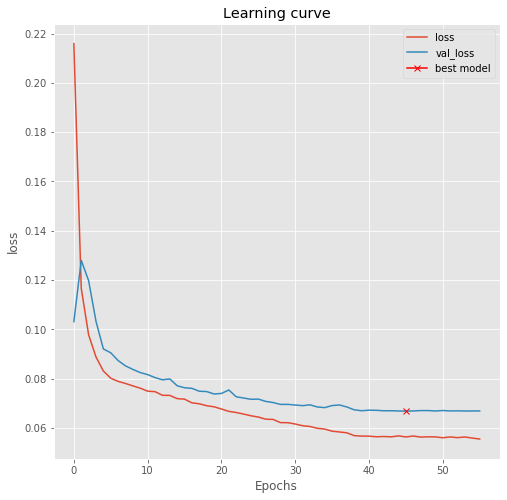

In [20]:
plt.figure(figsize=(8, 8))
plt.title("Learning curve")
plt.plot(results.history["loss"], label="loss")
plt.plot(results.history["val_loss"], label="val_loss")
plt.plot( np.argmin(results.history["val_loss"]), np.min(results.history["val_loss"]), marker="x", color="r", label="best model")
plt.xlabel("Epochs")
plt.ylabel("loss")
plt.legend();

In [21]:
# Load best model
model.load_weights('model_vessel-outer-segmentation.h5')

In [22]:
# Evaluate on validation set (this must be equals to the best log_loss)
model.evaluate(X_valid, y_valid, verbose=1)

110/110 [==============================] - ETA:  - ETA:  - 0s 927us/step


[0.07084717317060991, 0.9312849543311379, 0.92915282682939]

In [32]:
model.evaluate(X_test, y_test, verbose=1)

110/110 [==============================] - ETA:  - ETA:  - 0s 1ms/step


[0.07245494994250211, 0.929202547940341, 0.9275450500574979]

In [23]:
# Predict on train, val and test
preds_train = model.predict(X_train, verbose=1)
preds_valid = model.predict(X_valid, verbose=1)

# Threshold predictions
preds_train_t = (preds_train > 0.5).astype(np.uint8)
preds_valid_t = (preds_valid > 0.5).astype(np.uint8)

110/110 [==============================] - ETA:  - ETA:  - 0s 1ms/step


C:\Users\E.Lavrova\AppData\Local\conda\conda\envs\lisa\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


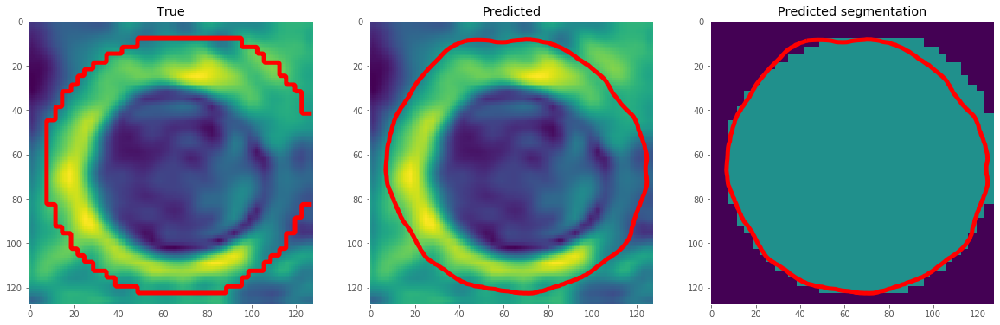

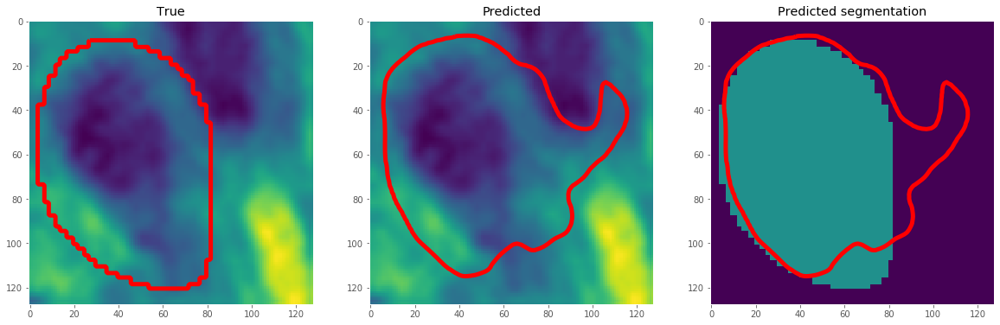

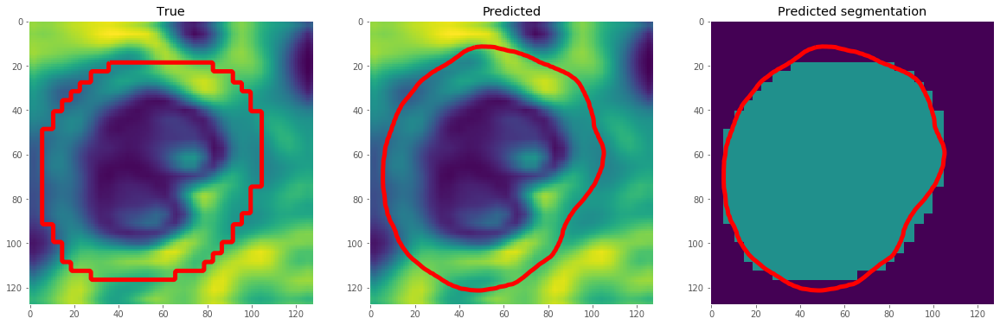

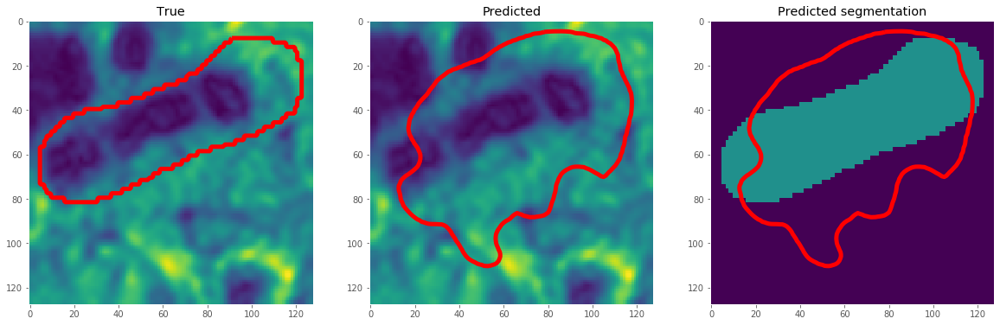

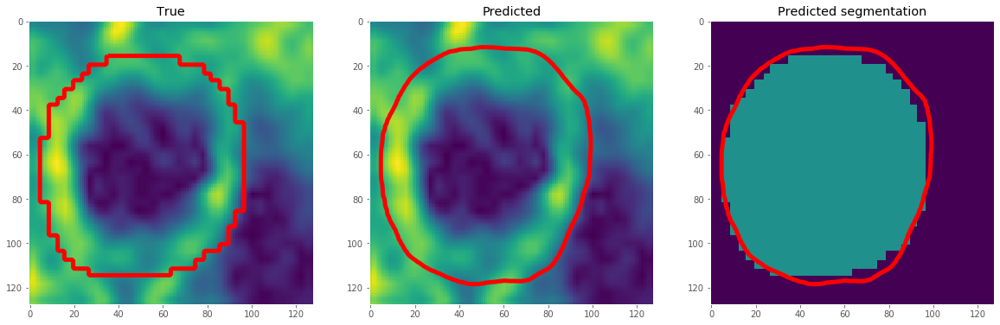

...

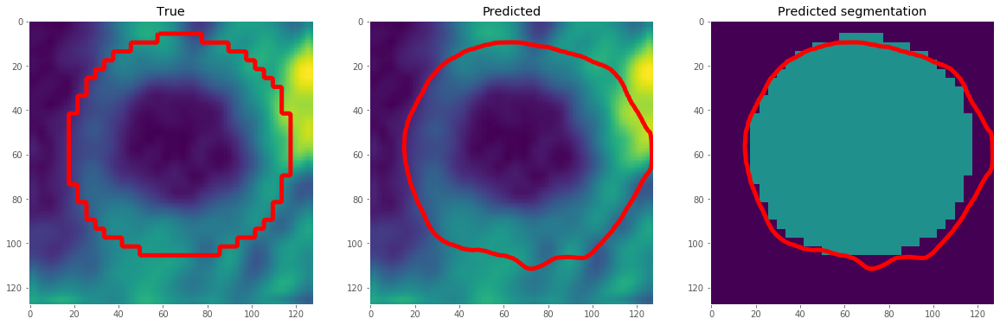

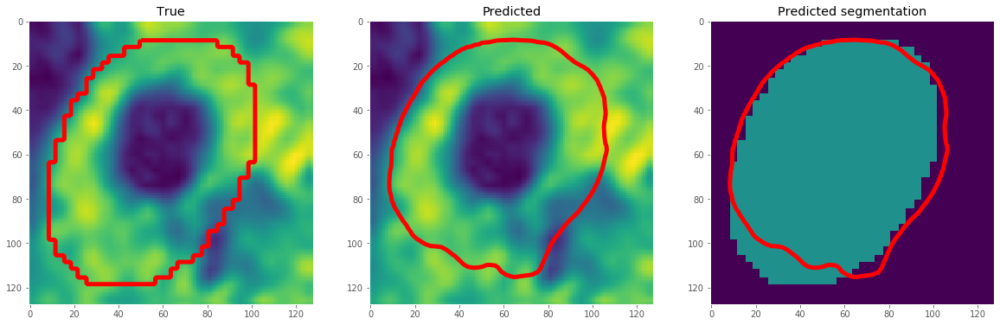

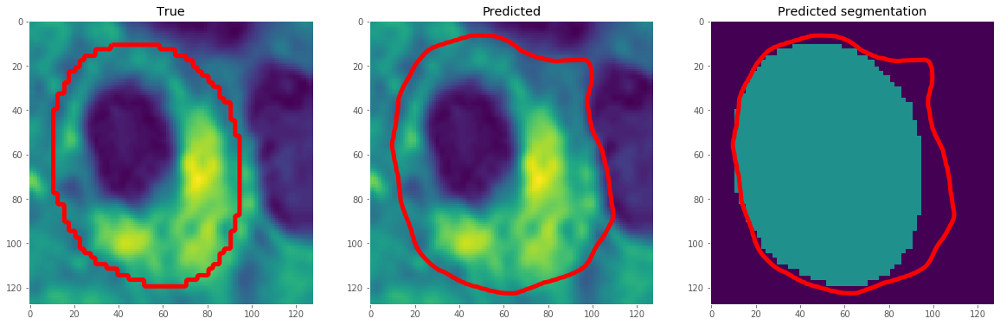

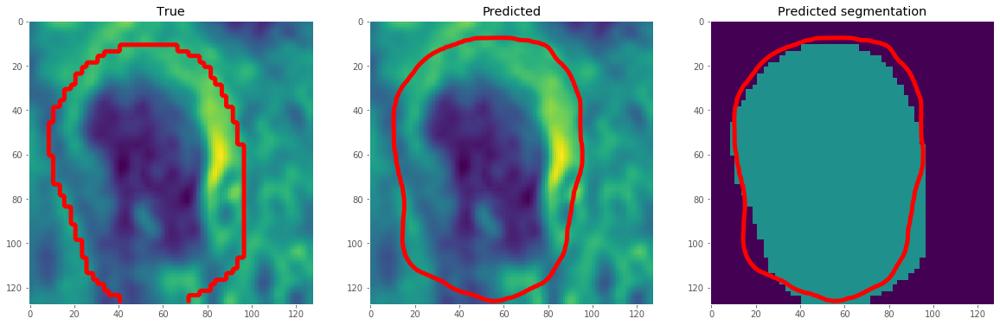

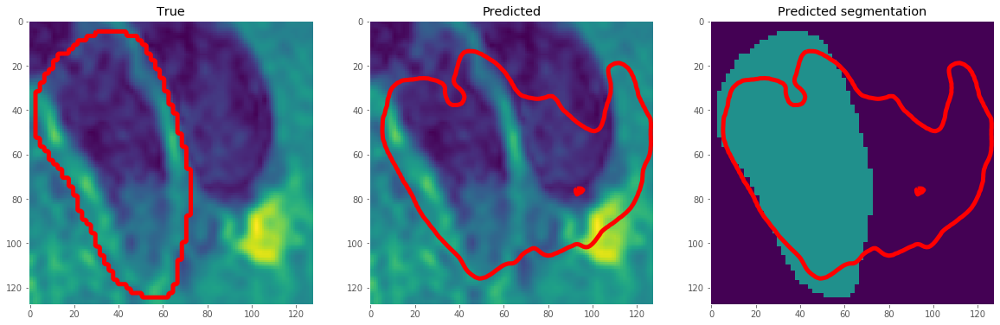

In [26]:
for ix in range (0, len(y_valid)):

    fig, ax = plt.subplots(1, 3, figsize=(20, 10))
    ax[0].imshow(X_valid[ix, ..., 0], cmap='viridis')
    ax[0].contour(y_valid[ix].squeeze(), colors='r', levels=[0.5, 1.5], linewidths=5)
    ax[0].set_title('True')
    ax[0].grid(False)

    ax[1].imshow(X_valid[ix, ..., 0], cmap='viridis')
    ax[1].contour(preds_valid[ix].squeeze(), colors='r', levels=[0.5, 1.5], linewidths=5)
    ax[1].set_title('Predicted')
    ax[1].grid(False)

    ax[2].imshow(y_valid[ix].squeeze(), vmin=0, vmax=2)
    ax[2].contour(preds_valid[ix].squeeze(), colors='r', levels=[0.5, 1.5], linewidths=5)
    ax[2].set_title('Predicted segmentation')
    ax[2].grid(False)
    
    plt.savefig('Z:/Lisa/temp/'+str(ix)+'_outer.png')


In [28]:
model_in = get_unet(input_img, n_filters=16, dropout=0.05, batchnorm=True)
model_in.load_weights('model_vessel-inner-segmentation.h5')

In [29]:
preds_in_valid = model_in.predict(X_valid, verbose=1)
preds_in_valid_t = (preds_in_valid > 0.5).astype(np.uint8)

110/110 [==============================] - ETA:  - 1s 7ms/step


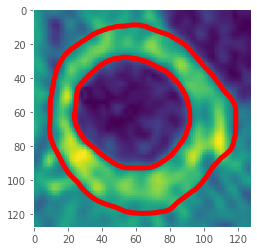

In [31]:
ix = 70

plt.imshow(X_valid[ix, ..., 0], cmap='viridis')
plt.contour(preds_valid[ix].squeeze(), colors='r', levels=[0.5, 1.5], linewidths=5)
plt.contour(preds_in_valid[ix].squeeze(), colors='r', levels=[0.5, 1.5], linewidths=5)
plt.grid(False)